# Цели проекта

* Загрузить и выполнить предобработку данных
* Проанализировать данные и выявить самые популярные сети
* Выявить улицы, на которых находится больше всего заведений
* Построить карту Москвы с ценами в зависимости от округа и оценок
* Посчитать количество кофеен в датасете и проиллюстрировать их рейтинги
* Выявить среднюю цену капучино 

# Введение.

У нас есть данные о заведения Москвы, которые содержат данные о среднем чеке, количестве посадочных мест, категории заведения, рейтинге, округе расположения заведения и координаты заведения. 

##  Извлечение данных.

In [1]:
import pandas as pd
import re
import plotly.express as px
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium import Map, Marker, Choropleth
from folium.plugins import MarkerCluster, HeatMap
import plotly.graph_objects as go

In [2]:
# Создаем необходимые для работы с данными фукнции

def load_and_clean_data(file_path):
    
    data = pd.read_csv(file_path)

    print(data.info())

    duplicate_rows = data.duplicated().sum()
    print("количество дубликатов:", duplicate_rows)
    
    print( data.isnull().sum())

   
    return data

def street_name(data):
    try:
        street_name = re.search(r'(?<=, )(.*?)(?=, |,\d|, корп\. |/\d|$)', data['address']).group()# с помощью регулярного выражения ищем названия улиц
    except:
        street_name = 'неверный адрес'
    if re.search(r'округ', data['address']): # в данных есть адреса, где указан округ, но нет адреса. Такие адреса нам не подходят.
        
        street_name = 'неверный адрес'
    elif re.search(r'мкад', data['address']): # помимо адресов в Москве, есть данные по Мкаду, чтобы их заполнить наиболее точно, поступим так
        
        street_name = re.search(r'мкад', data['address']).group()
    elif re.search(r'парк |парка |заказник|сквер|сад', data['address']): # в данных есть заведения в парках, чтобы они тоже не потерялись, заполним их так
        
        street_name = re.sub(r'\w+,', '', data['address'])
    elif re.search(r'проектируемый проезд', data['address']): # похожим образом как и Мкад, мы заполним проектируемые проезды
        
        street_name = re.sub(r'\w+,', '', data['address'])
    
    
    return street_name

def is_24(row):
    if row['hours']=='ежедневно, круглосуточно': # если совпадают эти условия, то возвращается True
        return True
    else:
        return False
    
def rating_classifier(row):
    if row['rating'] >= 4.5: # Такие критерии я взял отталкиваясь от того, как пользователи смотрят на рейтинги, а не от математических значений
        return "Высокий рейтинг"
    elif row['rating'] >= 4.3:
        return "Средний рейтинг"
    elif row['rating'] >= 4:
        return "Ниже среднего"
    else:
        return "Низкий рейтинг"

def data_district(data):
# Строим таблицу с медианами для среднего чека, рейтинга и количества мест, потом с помощью join присоединяем
# данные с общим количеством заведений, а потом считаем количество 24 часовых заведений
# Для этого суммируем количество true
    if str(data['category'].unique())==str(["кофейня"]):
        data = data.pivot_table(values=['middle_coffee_cup','rating','seats'],columns=['is_chain'], 
                                            index='district',aggfunc=['median']).join( 
        data.pivot_table(values=['name'],columns=['is_chain'], index='district',aggfunc=['count'])).join( 
        data.pivot_table(values=['is_24'],columns=['is_chain'], index='district',aggfunc=['sum']))
        data.columns = data.columns.droplevel(0)
        data.columns = data.columns.to_flat_index()
        data = data.sort_values([('middle_coffee_cup', 'не сетевое'),('rating', 'не сетевое')], ascending=[False,False]
                               )
        return data
    else:
        
        data = data.pivot_table(values=['middle_avg_bill','rating','seats'],columns=['is_chain'], 
                                            index='district',aggfunc=['median']).join( 
        data.pivot_table(values=['name'],columns=['is_chain'], index='district',aggfunc=['count'])).join( 
        data.pivot_table(values=['is_24'],columns=['is_chain'], index='district',aggfunc=['sum']))
        data.columns = data.columns.droplevel(0)
        data.columns = data.columns.to_flat_index()
        data = data.sort_values([('middle_avg_bill', 'не сетевое'),('rating', 'не сетевое')], ascending=[False,False])
        
        return data

def data_category(data):
    data = data.pivot_table(values=['middle_avg_bill','rating','seats'],columns=['is_chain'], 
                                            index='category',aggfunc=['median']).join( 
    data.pivot_table(values=['name'],columns=['is_chain'], index='category',aggfunc=['count'])).join( 
    data.pivot_table(values=['is_24'],columns=['is_chain'], index='category',aggfunc=['sum']))
    data.columns = data.columns.droplevel(0)
    data.columns = data.columns.to_flat_index()
    data = data.sort_values([('middle_avg_bill', 'не сетевое'),('rating', 'не сетевое')], ascending=[False,False])
    
    return data

    



### Основная информация о полученных данных

Посмотрим основную информацию о базе данных при помощи функции.

In [3]:
data = load_and_clean_data('/Users/sergeytischenko/Downloads/moscow_places.csv')

data

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB
None
количество дубликатов: 0
name                    0
categ

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8401,Суши Мания,кафе,"Москва, Профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 09:00–02:00",55.670021,37.552480,4.4,NaN,NaN,NaN,NaN,0,86.0
8402,Миславнес,кафе,"Москва, Пролетарский проспект, 19, корп. 1",Южный административный округ,"ежедневно, 08:00–22:00",55.640875,37.656553,4.8,NaN,NaN,NaN,NaN,0,150.0
8403,Самовар,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,NaN,Средний счёт:от 150 ₽,150.0,NaN,0,150.0
8404,Чайхана Sabr,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,NaN,NaN,NaN,NaN,1,150.0


Как видим, полных дубликатов нет, типы данных присвоены верно. Есть пропуски в часах работы, в ценах, и количестве посадочных мест.

In [4]:
data['name'] = data['name'].str.lower()


data['address'] = data['address'].str.lower()

Чтобы убедиться что в паре "название и адрес" нет дубликатов, приведем их к нижнему регистру и выведем дубликаты, если они есть.

In [5]:
data[data[['address','name']].duplicated()]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
215,кафе,кафе,"москва, парк ангарские пруды",Северный административный округ,"ежедневно, 10:00–22:00",55.881438,37.531848,3.2,NaN,NaN,NaN,NaN,0,NaN
1511,more poke,ресторан,"москва, волоколамское шоссе, 11, стр. 2",Северный административный округ,"пн-чт 09:00–18:00; пт,сб 09:00–21:00; вс 09:00...",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,1,188.0
2420,раковарня клешни и хвосты,"бар,паб","москва, проспект мира, 118",Северо-Восточный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–01:00; вс 12:00...",55.810677,37.638379,4.4,NaN,NaN,NaN,NaN,1,150.0
3109,хлеб да выпечка,кафе,"москва, ярцевская улица, 19",Западный административный округ,NaN,55.738449,37.410937,4.1,NaN,NaN,NaN,NaN,0,276.0


Как видим, есть два 4 дубликата по этим парам. Удалим их

In [6]:
data = data.drop_duplicates(subset=['address', 'name'])

В будущем графики будет удобно строить используя понятные и русские строки, поэтому создадим новый столбец и заменим там свойство сетевое и несетевое 

In [7]:
# Для удобства построения графиков создадим новый столбец с понятным текстом
pd.options.mode.chained_assignment = None 
data['is_chain'] = data['chain'].replace({0: 'не сетевое', 1: 'сетевое'}) 
data

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,is_chain
0,wowфли,кафе,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,не сетевое
1,четыре комнаты,ресторан,"москва, улица дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,не сетевое
2,хазри,кафе,"москва, клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,не сетевое
3,dormouse coffee shop,кофейня,"москва, улица маршала федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,не сетевое
4,иль марко,пиццерия,"москва, правобережная улица, 1б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,сетевое
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8401,суши мания,кафе,"москва, профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 09:00–02:00",55.670021,37.552480,4.4,NaN,NaN,NaN,NaN,0,86.0,не сетевое
8402,миславнес,кафе,"москва, пролетарский проспект, 19, корп. 1",Южный административный округ,"ежедневно, 08:00–22:00",55.640875,37.656553,4.8,NaN,NaN,NaN,NaN,0,150.0,не сетевое
8403,самовар,кафе,"москва, люблинская улица, 112а, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,NaN,Средний счёт:от 150 ₽,150.0,NaN,0,150.0,не сетевое
8404,чайхана sabr,кафе,"москва, люблинская улица, 112а, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,NaN,NaN,NaN,NaN,1,150.0,сетевое


### Общее количество заведений и создание новых столбцов

In [8]:
print(f"всего в представлены данные о {data['name'].nunique()} количестве заведений")


всего в представлены данные о 5512 количестве заведений


Всего в данных много пропусков, но заполнить их чем-то не представляется возможным, так как нам неоткуда брать информацию о количестве посадочных мест, ценах. 

In [9]:

data['street'] = data.apply(street_name, axis=1) # при помощи функции заполним данные об улицах 

data

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,is_chain,street
0,wowфли,кафе,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,не сетевое,улица дыбенко
1,четыре комнаты,ресторан,"москва, улица дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,не сетевое,улица дыбенко
2,хазри,кафе,"москва, клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,не сетевое,клязьминская улица
3,dormouse coffee shop,кофейня,"москва, улица маршала федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,не сетевое,улица маршала федоренко
4,иль марко,пиццерия,"москва, правобережная улица, 1б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,сетевое,правобережная улица
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8401,суши мания,кафе,"москва, профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 09:00–02:00",55.670021,37.552480,4.4,NaN,NaN,NaN,NaN,0,86.0,не сетевое,профсоюзная улица
8402,миславнес,кафе,"москва, пролетарский проспект, 19, корп. 1",Южный административный округ,"ежедневно, 08:00–22:00",55.640875,37.656553,4.8,NaN,NaN,NaN,NaN,0,150.0,не сетевое,пролетарский проспект
8403,самовар,кафе,"москва, люблинская улица, 112а, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,NaN,Средний счёт:от 150 ₽,150.0,NaN,0,150.0,не сетевое,люблинская улица
8404,чайхана sabr,кафе,"москва, люблинская улица, 112а, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,NaN,NaN,NaN,NaN,1,150.0,сетевое,люблинская улица


In [10]:
data['is_24'] = data.apply(is_24, axis=1) # при помощи функции заполним данные о круглосуточных заведениях
data

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,is_chain,street,is_24
0,wowфли,кафе,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,не сетевое,улица дыбенко,False
1,четыре комнаты,ресторан,"москва, улица дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,не сетевое,улица дыбенко,False
2,хазри,кафе,"москва, клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,не сетевое,клязьминская улица,False
3,dormouse coffee shop,кофейня,"москва, улица маршала федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,не сетевое,улица маршала федоренко,False
4,иль марко,пиццерия,"москва, правобережная улица, 1б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,сетевое,правобережная улица,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8401,суши мания,кафе,"москва, профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 09:00–02:00",55.670021,37.552480,4.4,NaN,NaN,NaN,NaN,0,86.0,не сетевое,профсоюзная улица,False
8402,миславнес,кафе,"москва, пролетарский проспект, 19, корп. 1",Южный административный округ,"ежедневно, 08:00–22:00",55.640875,37.656553,4.8,NaN,NaN,NaN,NaN,0,150.0,не сетевое,пролетарский проспект,False
8403,самовар,кафе,"москва, люблинская улица, 112а, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,NaN,Средний счёт:от 150 ₽,150.0,NaN,0,150.0,не сетевое,люблинская улица,True
8404,чайхана sabr,кафе,"москва, люблинская улица, 112а, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,NaN,NaN,NaN,NaN,1,150.0,сетевое,люблинская улица,True


**Итог первой части**
Столбцы с информацией об улицах и круглосуточных заведениях, удалены 4 выявленных дубликата.

## Исследование информации

Исследуем количество заведений каждой категории. 

In [11]:
category_counts= data.groupby(['category', ]).agg(количество=(
    'category', 'count')).sort_values('количество', ascending=False).reset_index()
category_counts

,category,количество
0,кафе,2376
1,ресторан,2042
2,кофейня,1413
3,"бар,паб",764
4,пиццерия,633
5,быстрое питание,603
6,столовая,315
7,булочная,256


### Количество заведений по категориям

In [12]:
fig = px.bar(category_counts,x='количество',y='category',text='количество', labels={
                     "category": "категория заведения",
                     
                     
                 },
                title="Количество заведений по категориям" )
fig.show()

В полученном датасете больше всего кафе, ресторанов и кофеен. Меньше всего булочных. 

In [13]:
category_seats = data.groupby('category')['seats'].median().sort_values(ascending=False) # посадочные места с учетом медианы
category_seats = category_seats.to_frame()

### Количество сидячих мест по категориям

In [14]:
fig = px.bar(category_seats,y='seats',text='seats', labels={
                     "seats": "количество сидячих мест",
                     
                     "category": "категория заведения"
                 },
                title="Количество сидячих мест в заведениях по категориям" )
fig.show()

При беглом взгляде на таблицу показалось что данные о посадочных местах содеражат вбросы, поэтому мы строим график по медиане, а сейчас потдвердим или опровергнем гипотезу.

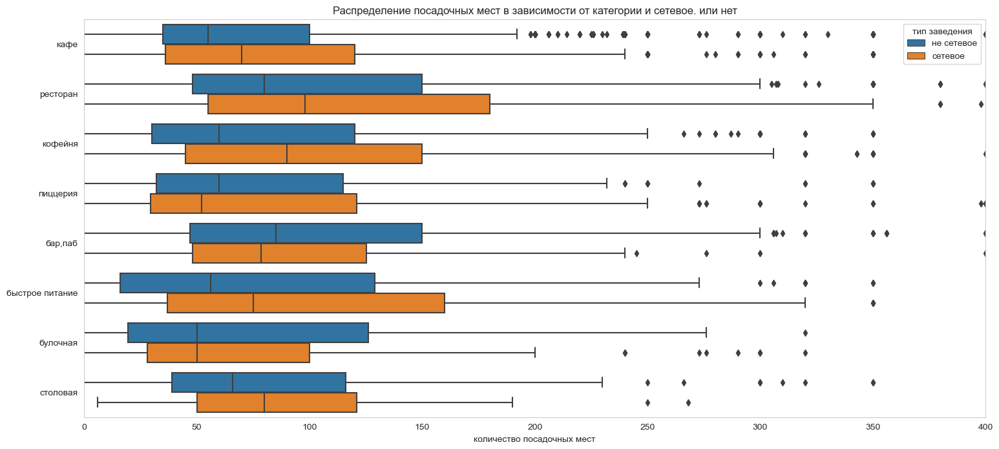

In [15]:

sns.set_style("whitegrid", {'axes.grid' : False})
# назначаем размер графика
plt.figure(figsize=(18, 8))

sns.boxplot(x='seats',y='category', hue='is_chain', data=data)
plt.xlim(0,400)
# указываем заголовок графика и подписи осей средствами matplotlib
plt.title('Распределение посадочных мест в зависимости от категории и сетевое. или нет')
plt.xlabel('количество посадочных мест')
plt.legend(title='тип заведения')
plt.ylabel(None)
# отображаем график на экране
plt.show()

Действительно в данных много вбросов. Но, учитывая мой личный опыт посещения кофеен, даже 250 посадочных мест в несетевых кофейнях - это слишком много. Так же 300 для сетевых кофеен - это тоже слишком много, так как сюда включены данные о таких кофейнях как cofix и one price coffee, которые ориентированы на поток, и имеют очень мало посадочных мест. Так что думаю что в этой части данных ошибка.  

### Распределение по сетевым и не сетевым заведениям

Посмотрим как распределяются данные о типах сетевое или не сетевое заведение в целом

In [16]:
fig = px.pie(values=data['chain'].value_counts(), names=list(data['is_chain'].unique()))
fig.show()

Большая часть заведений не сетевые. Думаю, это похоже на правду, потому что тянуть требования по франшизе не все готовы, но иметь свой бизнес хочется многим. Ну и если бизнес успешен, то не у всех есть желание развиваться в сетевое заведение, так как управлять таким бизнесом сложнее.

In [17]:
data_2= data.groupby(['category', 'is_chain']).agg(количество=(
    'category', 'count')).sort_values('количество', ascending=False).reset_index()
data_2

,category,is_chain,количество
0,кафе,не сетевое,1597
1,ресторан,не сетевое,1313
2,кафе,сетевое,779
3,ресторан,сетевое,729
4,кофейня,сетевое,720
5,кофейня,не сетевое,693
6,"бар,паб",не сетевое,596
7,быстрое питание,не сетевое,371
8,пиццерия,сетевое,330
9,пиццерия,не сетевое,303


In [18]:
fig = px.bar(data_2, x="category", y="количество", color="is_chain", text="количество",labels={
                     "количество": "количество заведений",
                     
                     "category": "категория заведения",
                        "is_chain":"тип заведения"
                 },
                title="Количество сетевых и не сетевых заведений по категориям"  ).update_xaxes(categoryorder="total descending")

fig.show()

Большинство кафе, ресторанов не сетевые. Как правило, это мелкие или крупные заведения с очень четкой концепцией и целевой аудиторией. Если хороший ресторан с очень изысканной публикой станет сетевым, то он потеряет статусность (возможность встречать нужных людей), а значит будет не так интересен аудитории. Так же большая часть кафе не сетевые, так как это небольшие, семейные проекты или индивидуальных предпренимателей. Другая ситуация в мире кофеен,пиццерий и быстрого питания. Тут не сетевых заведений меньше, чем сетевых. С пиццериями и быстрым питанием это можно обьяснить тем, что пиццерия - это вариация быстрого питания, где сетевым заведениям легче поддерживать низкие цены. С кофейнями другая ситуация. Сетевым заведениям приходится конкурировать с не сетевыми, чтобы показать свою состоятельность. При этом несетевые гораздо быстрее изменяются и дают людям то, что им нужно (много видов молока, dog's friendly и так далее)

In [19]:
chains = data.groupby("name").size().reset_index(name='counts')

chains = chains.sort_values(by='counts', ascending=False)

top_15_chains = chains.head(16)
top_15_chains = top_15_chains.query('name!="кафе"')
display(top_15_chains)

,name,counts
5418,шоколадница,120
2532,домино'с пицца,77
2500,додо пицца,74
1137,one price coffee,72
5491,яндекс лавка,69
413,cofix,65
1263,prime,50
4993,хинкальная,44
5319,шаурма,43
3178,кофепорт,42


### Самые популярные сети в Москве

In [20]:
fig = px.bar(top_15_chains,y='name',x='counts',text='counts', labels={
                     "counts": "количество заведений",
                     
                     "name": "название",
                       
                 },
                title="Количество самых популярных заведений" )
fig.show()

Самые популярные заведения - это безымянные кафе. Скорее всего, они не очень беспокоятся насчет узнаваемости, а ориентируются на высокую проходимость. Есть предположение что они находятся на Мкад или других шоссе, и ориентируются на проезжающие мимо авто. Почти наверняка- это не сетевые заведения.
Так же популярные заведения - это быстрого питания, пиццерии, или шоколодница. Сетевые кофейни cofix one, price coffee.


In [21]:
out = [' шоссе']
data_cafe = data.query('name== "кафе"& chain==0')

data_cafe = data_cafe[data_cafe['street'].str.contains(
    '| ' .join(out))]
len(data_cafe)

19

In [22]:
len(data.query('name== "кафе"& chain==0& street=="мкад"'))

10

In [23]:
print(len(data.query('name== "кафе"& chain==0')))
print(len(data.query('name== "кафе"& chain==1')))

188
0


Это и правда все не сетевые заведения, а значит это и правда просто безымянные кафе, а не сеть кафе с названием "кафе". Но не все из них находятся на шоссе или Мкад, так что возможно, тут просто данные не до конца были считаны или корректно заполнены. 

In [24]:
print(f"У нас есть данные по {list(data['district'].unique())}")

У нас есть данные по ['Северный административный округ', 'Северо-Восточный административный округ', 'Северо-Западный административный округ', 'Западный административный округ', 'Центральный административный округ', 'Восточный административный округ', 'Юго-Восточный административный округ', 'Южный административный округ', 'Юго-Западный административный округ']


Не хватает данных по Зеленоградскому, Троицкому, и Новомоскому округам. Зеленоградский в составе Москвы с 25 ноября 1968. С 1 июля 2012 года в Москву вошли Троиций и Новомосковский округа. Не думаю что это данные настолько старые, а значит в них умышленно не стали включать эти округа. По видимому, они не рассматривают там открытие кофейни.

In [25]:
district_data= data.groupby(['category',  'district']).agg(количество=(
    'category', 'count')).sort_values('количество', ascending=False).reset_index('category')

district_data = district_data.reset_index()
district_data

,district,category,количество
0,Центральный административный округ,ресторан,670
1,Центральный административный округ,кафе,464
2,Центральный административный округ,кофейня,428
3,Центральный административный округ,"бар,паб",364
4,Юго-Восточный административный округ,кафе,282
...,...,...,...
67,Северо-Западный административный округ,"бар,паб",23
68,Северо-Западный административный округ,столовая,18
69,Юго-Западный административный округ,столовая,17
70,Юго-Восточный административный округ,булочная,13


### Количество заведений по округам

In [26]:
fig = px.bar(district_data, x="district", y="количество", color="category", text="количество",labels={
                     "количество": "количество заведений",
                     
                     "category": "категория заведения",
                        "district":"округ"
                 },
                title="Количество заведений по округам"  ).update_xaxes(categoryorder="total descending")

fig.show()

В центральном округе много самых разных заведений, начиная от булочных и заканчивая ресторанами. В других оркугах заведений значительно меньше. Меньше всего в Северо-западном округе

In [27]:
rating_district = data.pivot_table(values=['rating'], index=['district'],columns='category',aggfunc='mean')
rating_district

rating                            \
category                                  бар,паб  булочная быстрое питание   
district                                                                      
Восточный административный округ         4.315094  4.168000        4.043662   
Западный административный округ          4.398000  4.264865        3.969355   
Северный административный округ          4.327941  4.253846        3.975862   
Северо-Восточный административный округ  4.187097  4.342857        4.032927   
Северо-Западный административный округ   4.391304  4.283333        3.950000   
Центральный административный округ       4.486264  4.372000        4.234483   
Юго-Восточный административный округ     4.200000  4.038462        3.925373   
Юго-Западный административный округ      4.350000  4.155556        4.086885   
Южный административный округ             4.276471  4.340000        4.101176   

                                                                       \
category                                     кафе   кофейня  пиццерия   
district                                                                
Восточный административный округ         4.098162  4.282857  4.269444   
Западный административный округ          4.075630  4.195333  4.288732   
Северный административный округ          4.185043  4.291710  4.292208   
Северо-Восточный административный округ  4.053532  4.216981  4.255882   
Северо-Западный административный округ   4.047826  4.325806  4.337500   
Центральный административный округ       4.302371  4.336449  4.411504   
Юго-Восточный административный округ     4.047872  4.225843  4.185455   
Юго-Западный административный округ      4.036975  4.283333  4.340625   
Южный административный округ             4.093939  4.232824  4.258904   

                                                             
category                                 ресторан  столовая  
district                                                     
Восточный административный округ         4.186875  4.232500  
Западный административный округ          4.257339  4.112500  
Северный административный округ          4.290426  4.217073  
Северо-Восточный административный округ  4.209890  4.082500  
Северо-Западный административный округ   4.292661  4.188889  
Центральный административный округ       4.416119  4.315152  
Юго-Восточный административный округ     4.156552  4.104000  
Юго-Западный административный округ      4.225595  4.241176  
Южный административный округ             4.212376  4.261364

### Рейтинг заведений по округам

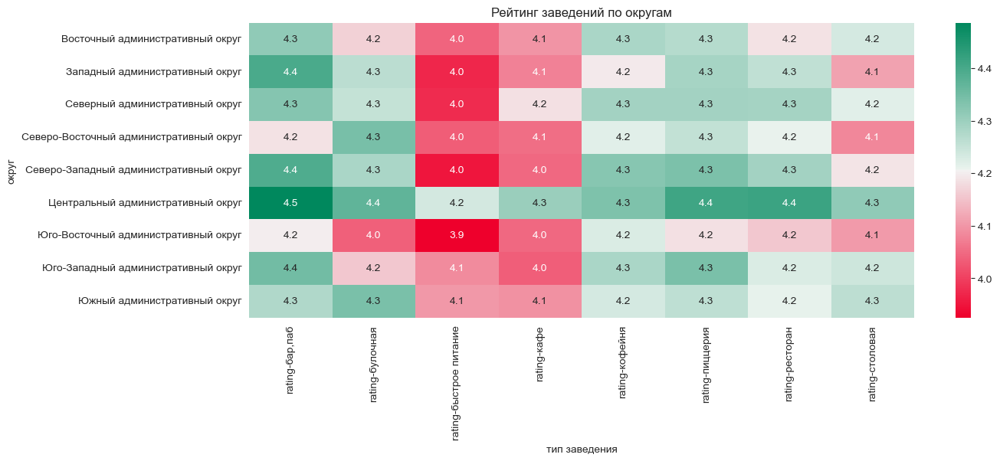

In [28]:
plt.figure(figsize=(14, 5))
cmap = sns.diverging_palette(10, 150, s=100, as_cmap=True)
ax = sns.heatmap(rating_district,  annot=True,cmap=cmap, fmt=".1f",)
ax.set(title='Рейтинг заведений по округам',
       xlabel='тип заведения', ylabel='округ')

plt.show()

Лучшие рейтинги у всех типов заведений в центре. Там даже сетевые быстрого питания стараются соответсвовать лучшим стандартам.  Как ни странно, но лучше всего оцениваются в среднем бары и пабы. Они в целом вообще хорошо оцениваются во всех округах. Кофейни тоже имеют неплохие оценки.  Худшая оценка у заведений быстрого питания на Северо-западе. Сложно сказать с чем это связано. Так же за звание худших округов по оценкам борятся Восточный и Юго-восточный. Это может быть связано с тем, что исторически они были промышленными, и только сейчас постепенно застраиваются и приобретают более высококачественные заведения. 

In [29]:
rating_df = data.groupby(['district'], as_index=False)['rating'].agg('median')
display(rating_df)

,district,rating
0,Восточный административный округ,4.3
1,Западный административный округ,4.3
2,Северный административный округ,4.3
3,Северо-Восточный административный округ,4.2
4,Северо-Западный административный округ,4.3
5,Центральный административный округ,4.4
6,Юго-Восточный административный округ,4.2
7,Юго-Западный административный округ,4.3
8,Южный административный округ,4.3


In [30]:

state_geo = '/Users/sergeytischenko/Downloads/admin_level_geomap.geojson'

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], tiles='openstreetmap', zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)
Choropleth(
    geo_data=state_geo,
    data=rating_df,
    columns=['district', 'rating',],
    key_on='feature.name',
    fill_color='RdYlGn',
    
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)
# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
data.apply(create_clusters, axis=1)
#hm = HeatMap(coffee_map_heat_map,
                #use_local_extrema=False).add_to(m)
folium.TileLayer("", name="None", attr="white").add_to(m)
m.add_child(folium.map.LayerControl(collapsed=True)) 

# выводим карту
m

Наиболее высокий рейтинг у заведений в центре. Во всех остальных остальных округах он ниже. При этом самый низкий на Юго-востоке и на Северо-востоке. 

In [31]:
# Создаем список с самыми популярными улицами.
top_15_streets = data.groupby([ 'street', ]).agg(количество=(
    'name', 'count')).sort_values('количество', ascending=False)
top_15_streets = top_15_streets.head(16)
 # так как в оказалось достаточно много ошибочных адресов чтобы попасть в подборку, отбросим их
top_15_streets = top_15_streets.query('street!="неверный адрес"')
top_15_streets = top_15_streets.index.to_list()

In [32]:
 # На основе этого списка в датасете оставляем данные только о популярных улицах
data_street_top = data.query('street in @top_15_streets')
data_street_top
data_street_top = data_street_top.groupby([ 'street','category',]).agg(counts=(
    'name', 'count')).sort_values('counts', ascending=False).reset_index()
data_street_top 

,street,category,counts
0,проспект мира,кафе,53
1,мкад,кафе,45
2,проспект мира,ресторан,45
3,проспект мира,кофейня,36
4,профсоюзная улица,кафе,35
...,...,...,...
106,люблинская улица,пиццерия,1
107,проспект вернадского,булочная,1
108,мкад,столовая,1
109,кутузовский проспект,булочная,1


### Количество  заведений на популярных улицах

In [33]:
fig = px.bar(data_street_top,x='street',y='counts',color='category', text='counts', labels={
                     "counts": "количество заведений",
                     
                     "street": "название улицы",
                       
                 },
                title="Количество самых популярных заведений" ).update_xaxes(categoryorder="total descending")
fig.show()

В основном в этот список попали улицы, которые на самом деле являются крупными шоссе в черте города. То есть, они сами по себе длинные и в виду их длины на них физически может располагаться очень много заведений. Но среди них есть и одно исклбчение - это Пятницкая улица. Это небольшая улица в центре города, на которой располагаются множество заведений буквально в каждом доме. Можно было ожидать появление здесь так же Арбата, но Пятницкая всё-таки длинее,

In [34]:
data_street_top = data.query('street in @top_15_streets')
data_street_top
data_street_top = data_street_top.groupby([ 'street','category','is_chain']).agg(counts=(
    'name', 'count')).sort_values('counts', ascending=False).reset_index()
data_street_top 

,street,category,is_chain,counts
0,проспект мира,кафе,не сетевое,37
1,проспект мира,ресторан,не сетевое,31
2,мкад,кафе,не сетевое,27
3,профсоюзная улица,кафе,не сетевое,26
4,ленинский проспект,ресторан,не сетевое,22
...,...,...,...,...
195,проспект вернадского,булочная,сетевое,1
196,проспект вернадского,"бар,паб",сетевое,1
197,ленинский проспект,быстрое питание,не сетевое,1
198,мкад,столовая,сетевое,1


In [36]:
# по аналогии как мы поступали с наиболее популярными улицами, формируем таблицу с наименее популярными улицами.
street_min = data.groupby([ 'street' ]).agg(количество=(
    'name', 'count')).sort_values('количество', ascending=True)
street_min = street_min.query('количество==1')
street_min

,количество
street,
№ 7,1
старокаширское шоссе,1
верхний сусальный переулок,1
верхнелихоборская улица,1
староконюшенный переулок,1
...,...
улица мжд киевское 5-й км,1
черёмушкинский проезд,1
2-я карачаровская улица,1


In [37]:
# Оставляем улицы, которые попались нам и содержат по одному заведению.
data_street_min = data.query('street in @street_min.index')
data_street_min

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,is_chain,street,is_24
15,дом обеда,столовая,"москва, улица бусиновская горка, 2",Северный административный округ,пн-пт 08:30–18:30; сб 10:00–20:00,55.885890,37.493264,4.1,средние,Средний счёт:300–500 ₽,400.0,NaN,0,180.0,не сетевое,улица бусиновская горка,False
21,7/12,кафе,"москва, прибрежный проезд, 7",Северный административный округ,"ежедневно, 10:00–22:00",55.876805,37.464934,4.5,NaN,NaN,NaN,NaN,0,NaN,не сетевое,прибрежный проезд,False
25,в парке вкуснее,кофейня,"москва, парк левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,NaN,NaN,NaN,1,NaN,сетевое,парк левобережный,False
58,coffeekaldi's,кофейня,"москва, угличская улица, 13, стр. 8",Северо-Восточный административный округ,"ежедневно, 09:00–22:00",55.900316,37.570558,4.1,средние,Средний счёт:500–800 ₽,650.0,NaN,1,NaN,сетевое,угличская улица,False
60,чебуречная история,кофейня,"москва, ландшафтный заказник лианозовский",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.899845,37.570488,4.9,NaN,NaN,NaN,NaN,1,NaN,сетевое,ландшафтный заказник лианозовский,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8289,мираж,ресторан,"москва, улица шкулёва, 2а",Юго-Восточный административный округ,"пн-пт 11:00–23:00; сб,вс 11:00–00:00",55.693340,37.746231,4.7,NaN,NaN,NaN,NaN,0,90.0,не сетевое,улица шкулёва,False
8294,wtfcoffee,кофейня,"москва, улица артюхиной, 14/8с1",Юго-Восточный административный округ,"ежедневно, 10:00–22:00",55.699044,37.737790,4.4,средние,NaN,NaN,NaN,0,NaN,не сетевое,улица артюхиной,False
8317,беседка,кафе,"москва, кузьминская улица, 10",Юго-Восточный административный округ,"ежедневно, 11:00–23:00",55.690691,37.787735,4.1,NaN,NaN,NaN,NaN,1,NaN,сетевое,кузьминская улица,False
8379,лагман хаус,кафе,"москва, новороссийская улица, 14, стр. 2",Юго-Восточный административный округ,"ежедневно, 10:00–00:00",55.678772,37.759422,4.3,NaN,NaN,NaN,NaN,1,40.0,сетевое,новороссийская улица,False


### Наименее популярные улицы и что их обьединяет.

In [38]:

data_district(data_street_min)

,"(middle_avg_bill, не сетевое)","(middle_avg_bill, сетевое)","(rating, не сетевое)","(rating, сетевое)","(seats, не сетевое)","(seats, сетевое)","(name, не сетевое)","(name, сетевое)","(is_24, не сетевое)","(is_24, сетевое)"
district,,,,,,,,,,
Центральный административный округ,1250.0,500.0,4.40,4.30,46.5,70.0,123,51,5,4
Северо-Западный административный округ,1250.0,2250.0,4.30,4.20,30.0,40.0,13,6,4,2
Юго-Восточный административный округ,1100.0,325.0,4.30,4.10,64.0,40.0,29,10,0,2
Западный административный округ,600.0,575.0,4.20,4.30,48.0,25.0,25,10,3,0
Юго-Западный административный округ,512.5,275.0,4.10,4.00,44.0,105.0,10,7,3,0
Восточный административный округ,462.5,600.0,4.30,4.30,41.0,0.0,39,13,2,1
Южный административный округ,450.0,290.0,4.15,4.15,40.0,21.0,36,10,1,2
Северный административный округ,425.0,600.0,4.30,4.20,52.5,27.5,37,14,1,0
Северо-Восточный административный округ,375.0,600.0,4.20,4.15,48.0,47.0,33,22,5,1


Большая часть заведений, которые находятся по 1 на улице в центре. Это не удивительно, так как в центре маленькие улочки, часто не обладают особой проходимостью, поэтому там находится не так много заведений. Так же сюда включились почти все заведения в парках, так как в парке тоже не много заведений. Но при этом у этих заведений рейтинг ниже, чем у всех заведений в целом. Так же можно сказать что очень малая часть из них работает 24 часа, в основном они работают не круглосуточно.

In [39]:
data_category(data_street_min)



,"(middle_avg_bill, не сетевое)","(middle_avg_bill, сетевое)","(rating, не сетевое)","(rating, сетевое)","(seats, не сетевое)","(seats, сетевое)","(name, не сетевое)","(name, сетевое)","(is_24, не сетевое)","(is_24, сетевое)"
category,,,,,,,,,,
ресторан,1300.0,1012.5,4.40,4.20,60.0,91.5,82,25,9,3
"бар,паб",1275.0,1000.0,4.40,4.65,46.0,100.0,36,6,1,1
пиццерия,850.0,575.0,4.40,4.30,39.0,35.0,7,9,0,0
кафе,600.0,400.0,4.20,4.20,44.0,40.0,119,45,8,7
кофейня,475.0,500.0,4.30,4.30,40.0,46.0,54,36,2,0
быстрое питание,425.0,450.0,4.30,3.75,31.5,22.5,16,8,3,1
столовая,265.0,275.0,4.30,4.30,75.0,104.0,27,9,0,0
булочная,NaN,NaN,4.35,4.40,36.0,10.0,4,5,1,0


Большая часть из заведений, которые находятся по 1 на улице - это маленькие с небольшим количеством посадочных мест. Но при этому у них достаточно высокий средний чек. Среди них почти нет 24 часовых, что не удивительно. Находятся они в мало проходимых местах, иначе бы там было больше заведений- конкурентов. При этом можно сказать что у них достаточно высокие рейтинги.

### Исследуем средний чек

In [40]:
disctrict_middle_avg_bill = data.pivot_table(values=['middle_avg_bill','rating','seats'], 
                                            index='district',aggfunc=['median']).reset_index()
disctrict_middle_avg_bill.columns = disctrict_middle_avg_bill.columns.droplevel(1)
disctrict_middle_avg_bill.columns = ['district', 'middle_avg_bill', 'rating','seats']
disctrict_middle_avg_bill['count_24'] = data.groupby([ 'district' ])\
.agg(total=('is_24', 'sum')).reset_index()['total']
disctrict_middle_avg_bill = disctrict_middle_avg_bill.sort_values(['middle_avg_bill','rating'], ascending=[False,False])
disctrict_middle_avg_bill

,district,middle_avg_bill,rating,seats,count_24
5,Центральный административный округ,1000.0,4.4,92.0,131
1,Западный административный округ,1000.0,4.3,90.0,72
4,Северо-Западный административный округ,700.0,4.3,85.0,43
2,Северный административный округ,650.0,4.3,60.0,71
7,Юго-Западный административный округ,600.0,4.3,70.0,73
0,Восточный административный округ,575.0,4.3,50.0,97
8,Южный административный округ,500.0,4.3,75.0,75
3,Северо-Восточный административный округ,500.0,4.2,70.0,75
6,Юго-Восточный административный округ,450.0,4.2,55.5,93


In [41]:

m = Map(location=[moscow_lat, moscow_lng], tiles='openstreetmap', zoom_start=10)
# создаём пустой кластер, добавляем его на карту


marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']} {row['middle_avg_bill']}",
    ).add_to(marker_cluster)
Choropleth(
    geo_data=state_geo,
    data=disctrict_middle_avg_bill,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlOrBr',
    
    legend_name='Медианный средний чек',
).add_to(m)
# применяем функцию create_clusters() к каждой строке датафрейма
data.apply(create_clusters, axis=1)
#hm = HeatMap(coffee_map_heat_map,
                #use_local_extrema=False).add_to(m)


Choropleth(
    geo_data=state_geo,
    data=disctrict_middle_avg_bill,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='RdYlGn',
    
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)
folium.TileLayer("", name="None", attr="white").add_to(m)
m.add_child(folium.map.LayerControl(collapsed=True)) 
# выводим карту
m

In [42]:
disctrict_middle_avg_bill['code_distr'] = disctrict_middle_avg_bill['district'].astype('category').cat.codes
disctrict_middle_avg_bill


,district,middle_avg_bill,rating,seats,count_24,code_distr
5,Центральный административный округ,1000.0,4.4,92.0,131,5
1,Западный административный округ,1000.0,4.3,90.0,72,1
4,Северо-Западный административный округ,700.0,4.3,85.0,43,4
2,Северный административный округ,650.0,4.3,60.0,71,2
7,Юго-Западный административный округ,600.0,4.3,70.0,73,7
0,Восточный административный округ,575.0,4.3,50.0,97,0
8,Южный административный округ,500.0,4.3,75.0,75,8
3,Северо-Восточный административный округ,500.0,4.2,70.0,75,3
6,Юго-Восточный административный округ,450.0,4.2,55.5,93,6


Самый высокий средний чек в центральном и западном округе. Это не удивительно. Именно эти округа являются самыми престижными в Москве. Именно там самая дорогая недвижимость и соответсвенно публика, готовая платить больше. В советское время туда селили наиболее престижные профессии. Сейчас хоть и прошло с того момента более 30 лет, но всё равно это вляиет до сих пор.  На юге и Юго-Востоке, исторически были промышленные районы, соответственно селили более простых людей. Сейчас происходит постепенный вывод промышленных площадей из Москвы, и замена их на жилые площади, но всё равно этого недостаточно чтобы переломить тенденции к среднему чеку. Странным исключением из этгго Северо-Восточный округ. Вероятнее всего так происходит потому что там большую площадь округа, стремящуюсмя к центру занимает ВДНХ и Ботанический сад. Ведь чем ближе к центру, тем цены всё-таки выше. 

### Взаимосвязь между оценкой, средним чеком и количеством посадочных мест

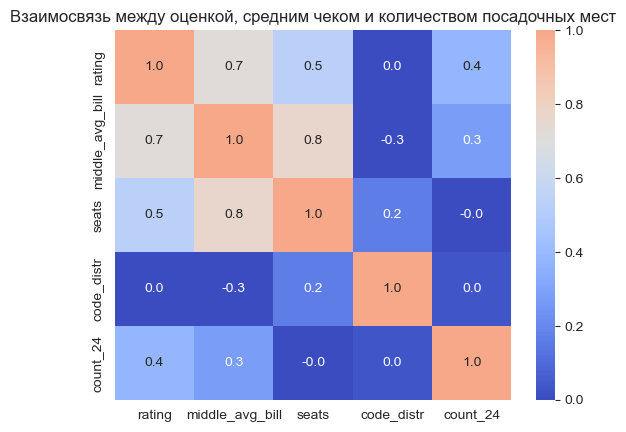

In [43]:
ax = sns.heatmap(disctrict_middle_avg_bill[['rating', 'middle_avg_bill','seats', 'code_distr','count_24' ]].corr(),
                 annot=True,cmap='coolwarm', fmt=".1f", vmin=0, vmax=1, center= 0.7)
ax.set(title='Взаимосвязь между оценкой, средним чеком и количеством посадочных мест')
plt.show()

Между рейтингом, и средним чеком и количеством посадочных мест есть взаимосвзь, что логично. Чем больше посадочных мест- тем больше вероятность что придут большие компании и будут долго и тщательно тратить большие суммы. Ну и соответсвенно, между рейтингом и средним чеком взаимосвязь такая, что в в более высоком ретинге заведения выше цены. 

### Как живется с низким рейтингом?

In [45]:
data['рейтинг'] = data.apply(rating_classifier, axis=1) 
data

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,is_chain,street,is_24,рейтинг
0,wowфли,кафе,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,не сетевое,улица дыбенко,False,Высокий рейтинг
1,четыре комнаты,ресторан,"москва, улица дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,не сетевое,улица дыбенко,False,Высокий рейтинг
2,хазри,кафе,"москва, клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,не сетевое,клязьминская улица,False,Высокий рейтинг
3,dormouse coffee shop,кофейня,"москва, улица маршала федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,не сетевое,улица маршала федоренко,False,Высокий рейтинг
4,иль марко,пиццерия,"москва, правобережная улица, 1б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,сетевое,правобережная улица,False,Высокий рейтинг
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8401,суши мания,кафе,"москва, профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 09:00–02:00",55.670021,37.552480,4.4,NaN,NaN,NaN,NaN,0,86.0,не сетевое,профсоюзная улица,False,Средний рейтинг
8402,миславнес,кафе,"москва, пролетарский проспект, 19, корп. 1",Южный административный округ,"ежедневно, 08:00–22:00",55.640875,37.656553,4.8,NaN,NaN,NaN,NaN,0,150.0,не сетевое,пролетарский проспект,False,Высокий рейтинг
8403,самовар,кафе,"москва, люблинская улица, 112а, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,NaN,Средний счёт:от 150 ₽,150.0,NaN,0,150.0,не сетевое,люблинская улица,True,Низкий рейтинг
8404,чайхана sabr,кафе,"москва, люблинская улица, 112а, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,NaN,NaN,NaN,NaN,1,150.0,сетевое,люблинская улица,True,Ниже среднего


In [46]:
data_rating_min = data.query('рейтинг=="Низкий рейтинг"')
data_district(data_rating_min)

,"(middle_avg_bill, не сетевое)","(middle_avg_bill, сетевое)","(rating, не сетевое)","(rating, сетевое)","(seats, не сетевое)","(seats, сетевое)","(name, не сетевое)","(name, сетевое)","(is_24, не сетевое)","(is_24, сетевое)"
district,,,,,,,,,,
Центральный административный округ,600.0,300.0,3.7,3.70,100.0,85.0,70,34,7,6
Западный административный округ,500.0,325.0,3.7,3.75,80.0,96.0,87,54,12,7
Северо-Восточный административный округ,425.0,400.0,3.6,3.60,85.0,98.0,103,48,12,4
Северный административный округ,400.0,400.0,3.7,3.70,45.0,51.5,72,50,7,6
Юго-Западный административный округ,350.0,362.5,3.6,3.70,60.0,75.0,70,48,11,10
Южный административный округ,337.5,435.0,3.5,3.70,80.0,67.0,110,45,15,7
Восточный административный округ,335.0,322.5,3.7,3.50,50.0,33.0,106,42,16,12
Юго-Восточный административный округ,287.5,400.0,3.6,3.45,58.0,50.0,112,58,22,13
Северо-Западный административный округ,285.0,400.0,3.6,3.70,60.0,99.0,43,16,8,3


Заведения с низким рейтинго есть во всех округах Москвы. Больще всего в Юго-Восточном и Южном. Меньше всего в центральном. Большая часть из них не сетевые, что логично, так как в сетях стараются поддерживать средний уровень. Можно так же сказать что у них очень низкий средний чек. Скорее всего, это закусочных и другие небольшие заведения.

In [47]:
data_category(data_rating_min)

,"(middle_avg_bill, не сетевое)","(middle_avg_bill, сетевое)","(rating, не сетевое)","(rating, сетевое)","(seats, не сетевое)","(seats, сетевое)","(name, не сетевое)","(name, сетевое)","(is_24, не сетевое)","(is_24, сетевое)"
category,,,,,,,,,,
"бар,паб",800.0,257.5,3.70,3.45,98.0,77.0,30,10,7,0
ресторан,700.0,387.5,3.60,3.70,81.0,46.0,100,77,14,4
пиццерия,575.0,400.0,3.70,3.70,155.0,36.0,20,15,1,4
кафе,450.0,450.0,3.60,3.60,50.0,50.0,409,133,43,37
булочная,350.0,325.0,3.70,3.70,32.5,70.0,13,17,4,2
столовая,320.0,262.5,3.75,3.70,100.0,60.0,36,8,0,0
быстрое питание,300.0,375.0,3.60,3.60,55.0,47.5,103,59,41,16
кофейня,277.5,400.0,3.70,3.70,56.0,110.0,62,76,0,5


Действительно. Большинтсво это быстрое питание и кафе, что тоже может быть как скорее как закусочная. При этом очень мало баров и булочных. Так же можно сказать что у них всех очень низкий средний чек за исключением не сетевых баров и ресторанов. Но это все равно ниже чем у высокорейтинговых заведений. 

In [48]:
custom_dict = {'Высокий рейтинг': 0, 'Средний рейтинг': 1, 'Ниже среднего': 2,'Низкий рейтинг':3} 
data.pivot_table(values=['name'],columns=['is_chain'],
                 index=[ 'category', 'рейтинг',],aggfunc=['count']).reset_index('рейтинг').sort_values(by=['рейтинг'], key=lambda x: x.map(custom_dict))

рейтинг      count        
                                       name        
is_chain                         не сетевое сетевое
category                                           
бар,паб          Высокий рейтинг        233      74
столовая         Высокий рейтинг         51      17
ресторан         Высокий рейтинг        424     143
булочная         Высокий рейтинг         25      36
пиццерия         Высокий рейтинг         90      54
быстрое питание  Высокий рейтинг         50      29
кофейня          Высокий рейтинг        234     102
кафе             Высокий рейтинг        299     187
ресторан         Средний рейтинг        501     290
пиццерия         Средний рейтинг        119     131
кофейня          Средний рейтинг        247     242
кафе             Средний рейтинг        423     244
столовая         Средний рейтинг         63      27
бар,паб          Средний рейтинг        247      62
быстрое питание  Средний рейтинг        108      62
булочная         Средний рейтинг         30      67
столовая           Ниже среднего         77      36
бар,паб            Ниже среднего         86      22
ресторан           Ниже среднего        288     219
булочная           Ниже среднего         31      37
пиццерия           Ниже среднего         74     130
кофейня            Ниже среднего        150     300
быстрое питание    Ниже среднего        110      82
кафе               Ниже среднего        466     215
кофейня           Низкий рейтинг         62      76
пиццерия          Низкий рейтинг         20      15
столовая          Низкий рейтинг         36       8
ресторан          Низкий рейтинг        100      77
бар,паб           Низкий рейтинг         30      10
кафе              Низкий рейтинг        409     133
булочная          Низкий рейтинг         13      17
быстрое питание   Низкий рейтинг        103      59

Всё-таки с низким рейтинг не так много заведений в целом. В основном - это кафе. Так же много ресторанов и кафе с рейтингом ниже среднего. Так же стоит отметить что в датасете очень мало низкорейтинговых кофеен, причем большая часть из них сетевые.

### Итоги раздела.
Мы выяснили что у нас в датасете больше всего кафе. Так же выявили количество сидячих мест, но пришли к выводу, что ориентироваться на них не стоит, так как они выглядят неправдаподобно. Выявили что большая часть из заведений всё-таки не сетевые. Самой популярной сетью в Москве является Шоколадница. Так же популярны сетевые пиццерии Додо и Доминос. 
Так же мы выявили закономерность, что лучшие по оценкам и самые дорогие заведения находятся в центре и в ЮЗАО. Не удивительно, ведь именно там проживают самые богатые и взыскательные люди. Меньше всего заведений в ЮВАО. 
Так же мы выяснили что больше всего заведений находятся на крупных шоссе, но так же и на Пятницкой улице. 
Мы выявили что есть взаимосвязь между средней оценкой и ценой, а так же между количеством посадочных мест.
Так же мы выяснили что лучше всего живется с низким рейтингом барам и пабам, остальные заведения не могут рассчитывать на хороший средний чек

## Открываем кофейню

In [49]:
coffee_map = data.query('category=="кофейня"')
print(f'всего в датасете: {len(coffee_map)} кофеен, из них работают 24 часа: {len(coffee_map.query("is_24 ==True"))} это {len(coffee_map.query("is_24 ==True"))*100/len(coffee_map):.2f}% от общего числа кофеен ')


всего в датасете: 1413 кофеен, из них работают 24 часа: 59 это 4.18% от общего числа кофеен 


In [50]:
data_district(coffee_map)


,"(middle_coffee_cup, не сетевое)","(middle_coffee_cup, сетевое)","(rating, не сетевое)","(rating, сетевое)","(seats, не сетевое)","(seats, сетевое)","(name, не сетевое)","(name, сетевое)","(is_24, не сетевое)","(is_24, сетевое)"
district,,,,,,,,,,
Центральный административный округ,195.0,180.0,4.40,4.3,50.0,100.0,207,221,6,20
Юго-Западный административный округ,190.5,199.5,4.40,4.3,50.0,72.5,46,50,2,5
Южный административный округ,170.0,109.5,4.40,4.2,80.0,75.0,65,66,0,1
Западный административный округ,170.0,222.5,4.30,4.2,98.0,96.0,57,93,1,8
Северо-Западный административный округ,165.0,172.0,4.45,4.2,25.5,125.0,28,34,0,2
Северный административный округ,165.0,140.0,4.40,4.2,70.0,60.5,96,97,0,5
Северо-Восточный административный округ,162.5,162.0,4.35,4.2,52.0,85.0,80,79,0,3
Юго-Восточный административный округ,150.0,130.0,4.35,4.2,54.0,50.0,60,29,0,1
Восточный административный округ,135.0,135.0,4.40,4.2,52.0,65.0,54,51,0,5


Большая часть 24 часовых кофеен находится в центре, что не удивительно. Причем в основном это сетевые кофейни. Так же можно сказать что у всех кофеен в датасете достаточно высокий рейтинг. Наимеенее конкурентный район- это Северо-западный округ. При этом самая дешевая чашка кофе в Восточном округе. 

In [51]:


fig = go.Figure(go.Indicator(
    mode = "gauge+number",
    value = coffee_map['rating'].median(),
    title = {'text': "Средняя оценка кофейни в датасете"},
    domain = {'x': [0, 1], 'y': [0, 1]},
    
    gauge = {'axis': {'range': [None, 5]},
             'steps' : [
                 {'range': [0, 4], 'color': "grey"},
                 {'range': [4, 5], 'color': "white"}],
             }))

fig.show()

In [52]:


fig = go.Figure(go.Indicator(
    mode = "gauge+number",
    value = coffee_map['middle_coffee_cup'].median(),
    title = {'text': "Средняя цена капучино"},
    domain = {'x': [0, 1], 'y': [0, 1]},
    
    gauge = {'axis': {'range': [None, coffee_map['middle_coffee_cup'].quantile(0.75)]},
             'steps' : [
                 {'range': [0, coffee_map['middle_coffee_cup'].quantile(0.25)], 'color': "grey"},
                 {'range': [coffee_map['middle_coffee_cup'].quantile(0.50), coffee_map['middle_coffee_cup'].quantile(0.75)], 'color': "white"}],
             }))

fig.show()

In [53]:


fig = go.Figure(go.Indicator(
    mode = "gauge+number",
    value = coffee_map['seats'].median(),
    title = {'text': "Среднее количество мест в кофейне"},
    domain = {'x': [0, 1], 'y': [0, 1]},
    
    gauge = {'axis': {'range': [None, coffee_map['seats'].quantile(0.75)]},
             'steps' : [
                 {'range': [0, coffee_map['seats'].quantile(0.25)], 'color': "grey"},
                 {'range': [coffee_map['seats'].quantile(0.50), coffee_map['seats'].quantile(0.75)], 'color': "white"}],
             }))

fig.show()

In [54]:
disctrict_coffee_middle_avg_bill = coffee_map.pivot_table(values=['middle_coffee_cup','rating','seats'], 
                                            index='district',aggfunc=['median']).reset_index()
disctrict_coffee_middle_avg_bill.columns = disctrict_coffee_middle_avg_bill.columns.droplevel(1)
disctrict_coffee_middle_avg_bill.columns = ['district', 'middle_coffee_cup', 'rating','seats']
disctrict_coffee_middle_avg_bill = disctrict_coffee_middle_avg_bill.sort_values('middle_coffee_cup', ascending=False)
disctrict_coffee_middle_avg_bill

,district,middle_coffee_cup,rating,seats
7,Юго-Западный административный округ,198.0,4.3,64.5
5,Центральный административный округ,190.0,4.3,86.0
1,Западный административный округ,189.0,4.2,96.0
4,Северо-Западный административный округ,165.0,4.3,87.5
3,Северо-Восточный административный округ,162.5,4.3,75.0
2,Северный административный округ,159.0,4.3,66.0
8,Южный административный округ,150.0,4.3,80.0
6,Юго-Восточный административный округ,147.5,4.3,50.0
0,Восточный административный округ,135.0,4.3,55.0


In [55]:
m = Map(location=[moscow_lat, moscow_lng], tiles='openstreetmap', zoom_start=10)
# создаём пустой кластер, добавляем его на карту


marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']} {row['middle_avg_bill']}",
    ).add_to(marker_cluster)
Choropleth(
    geo_data=state_geo,
    data=disctrict_coffee_middle_avg_bill,
    columns=['district', 'middle_coffee_cup'],
    key_on='feature.name',
    fill_color='YlOrBr',
    
    legend_name='Медианный средний чек',
).add_to(m)
# применяем функцию create_clusters() к каждой строке датафрейма
coffee_map.apply(create_clusters, axis=1)
#hm = HeatMap(coffee_map_heat_map,
                #use_local_extrema=False).add_to(m)


Choropleth(
    geo_data=state_geo,
    data=disctrict_coffee_middle_avg_bill,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='RdYlGn',
    
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)
folium.TileLayer("", name="None", attr="white").add_to(m)
m.add_child(folium.map.LayerControl(collapsed=True)) 
# выводим карту
m

Почему-то именно в западном округе наименьший рейтинг. Но при этом он не критично ниже других районов. При этом средний чек там почти такой же как в центре.

In [56]:
coffee_group = coffee_map.groupby([ 'is_24','is_chain','рейтинг']).agg(counts=(
    'name', 'count')).sort_values('counts', ascending=False).reset_index()

In [57]:

fig = px.sunburst(coffee_group, path=[ 'is_chain','is_24','рейтинг'], values='counts', color='is_chain')
fig.show()

### Итог раздела. 
В первую очередь я бы уточнил у заказчиков точно ли они хотят сделать свою кофейню доступной, так стилизовать кофейню под сериал достаочно не дешевое удовольствие, плюс придется платить отчисление за использование названия. Если они планируют не стилизовать, но прежде всего рассчитывают её сделать доступной, то стоит открывать её в Восточном округе, так как там наименьший средний чек среди кофеен. Так же стоит присмотреться к спальным районам Москвы ЮВАО И ВАО. Там заведений не так много, и люди точно были бы рады если бы рядом открылась кофейня с доступными ценами и хорошим кофе. При этом, я считаю что нужно рассчитывать на цену капучино в районе 170 рублей. Так как цены ниже как правило в кофейнях в формате кофе с собой типа Cofix,  One price Coffee. Для кофейни с посиделками в формате друзей точно не подходит формат с собой, а значит придется иметь достаточно большое помещение в аренде. 

 презентация: [ссылка на презентацию на яндекс диске](https://disk.yandex.ru/i/o0PzioMch-x3lA)